In [275]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [274]:
from datetime import datetime

import pandas as pd
import numpy as np

pd.set_option('display.max_rows',200)

# import missingno as msno
# from pandas_profiling import ProfileReport
# import folium

pd.set_option('display.max_columns',200)

# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"

from IPython.display import IFrame


In [95]:
train_data = pd.read_csv('data/training set values.csv')
train_labels = pd.read_csv('data/training set labels.csv')
test_data = pd.read_csv('data/test set values.csv')

In [96]:
train_data.shape
train_labels.shape
test_data.shape

(14850, 40)

In [97]:
train_data.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe


In [98]:
train_labels.head()

,id,status_group
0,69572,functional
1,8776,functional
2,34310,functional
3,67743,non functional
4,19728,functional


In [99]:
train = pd.merge(train_data,train_labels,on='id',how='left')

In [100]:
train.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional


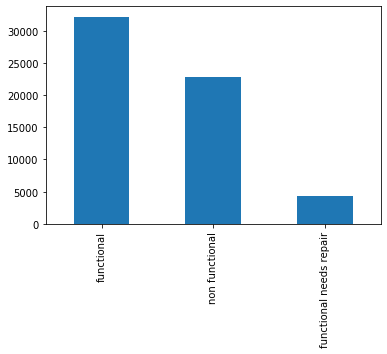

In [80]:
train['status_group'].value_counts().plot(kind='bar')

In [23]:
train['status_colour'] = train.status_group.replace('functional','green').replace('functional needs repair','orange').replace('non functional','red')

In [12]:
m = folium.Map(location=[train['latitude'].mean(),train['longitude'].mean()],tiles='Stamen Terrain',zoom_start=10)

In [13]:
for index,row in train.iterrows():
    folium.Circle([row['latitude'],row['longitude']],radius=15,color=row['status_colour']).add_to(m)

In [14]:
m.save('map.html')

In [15]:
from IPython.core.display import display, HTML
display(HTML("map.html"))

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


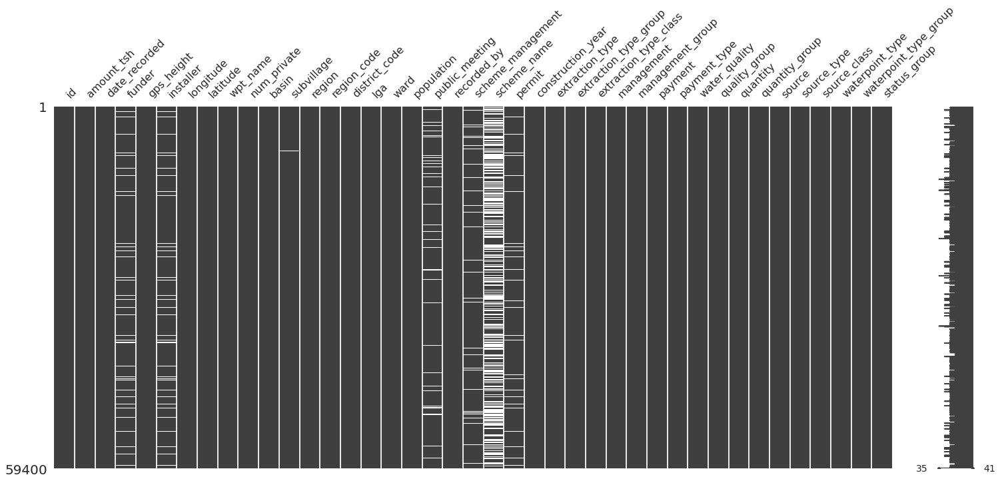

In [11]:
msno.matrix(train)

In [12]:
#profile = ProfileReport(train, title='Pandas Profiling Report', html={'style':{'full_width':True}})
#profile.to_file(output_file="profile_report.html")
#profile.to_notebook_iframe()

In [81]:
train.head(5)

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional


# Below steps on the back of profile report

In [107]:
std_scale = []

In [101]:
train.drop('id',axis=1,inplace=True)

In [102]:
# Very skewed, might be useful feature but removing for base model
train.drop('amount_tsh',axis=1,inplace=True)

In [103]:
#Date recorded shouldnt have any say on state
train.drop('date_recorded',axis=1,inplace=True)

In [104]:
# high cardinality
train.drop('funder',axis=1,inplace=True)

In [108]:
# should be a good feature but will need to be scaled
std_scale.append('gps_height')

In [109]:
# high cardinality missing 6% of data, in theory would have been good feature to compare better installers vs not so much
train.drop('installer',axis=1,inplace=True)

In [110]:
# Convert lat long to radians, read it somewhere
train['latitude'] = np.radians(train['latitude'])
train['longitude'] = np.radians(train['longitude'])

In [111]:
# high cardinality - also whats in the name
train.drop('wpt_name',axis=1,inplace=True)

In [112]:
# no description most of the values are zero
train.drop('num_private',axis=1,inplace=True)

In [113]:
train.shape

(59400, 34)

In [114]:
# good feature
train = pd.get_dummies(train, columns=['basin'],prefix=['basin'])

In [115]:
train.shape

(59400, 42)

In [116]:
# high cardinality
train.drop('subvillage',axis=1,inplace=True)

In [117]:
# region features
# Will use region and drop the other two.
train[['region','region_code','district_code']].fillna("missing").groupby(['region','region_code','district_code']).size()

region         region_code  district_code
Arusha         2            1                 189
                            2                1206
                            3                 109
                            5                 201
                            6                 310
                            7                1009
               24           30                326
Dar es Salaam  7            1                  93
                            2                 497
                            3                 215
Dodoma         1            0                  23
                            1                 888
                            3                 361
                            4                 347
                            5                 358
                            6                 224
Iringa         11           1                 728
                            2                 530
                            3                 650
        

In [118]:
train.shape

(59400, 41)

In [119]:
train = pd.get_dummies(train, columns=['region'], prefix = ['region'])

In [120]:
train.drop(['region_code','district_code'],axis=1,inplace=True)

In [121]:
train.shape

(59400, 59)

In [122]:
# high cardinality
train.drop('lga',axis=1,inplace=True)

In [123]:
# high cardinality
train.drop('ward',axis=1,inplace=True)

In [124]:
# population should be important, maybe in deep dive mode can get population from some source, for here and now dropping it.
train.drop('population',axis=1,inplace=True)

In [125]:
# no description
train.drop('public_meeting',axis=1,inplace=True)

In [126]:
#of no use
train.drop('recorded_by',axis=1,inplace=True)

In [127]:
# hhigh cardinality / missing 
train.drop('scheme_name',axis=1,inplace=True)

In [128]:
# hhigh cardinality / missing 
train['scheme_management'].fillna("Other",inplace=True)
train['scheme_management'] =  train['scheme_management'].str.replace("Other values (2)","Other").str.replace("None",'Other')
train['scheme_management'].value_counts()

VWC                 36793
WUG                  5206
Other                4644
Water authority      3153
WUA                  2883
Water Board          2748
Parastatal           1680
Private operator     1063
Company              1061
SWC                    97
Trust                  72
Name: scheme_management, dtype: int64

In [129]:
train.shape

(59400, 53)

In [130]:
train = pd.get_dummies(train,columns=['scheme_management'], prefix = ['scheme_management'])

In [132]:
train.shape

(59400, 63)

In [136]:
#permit
train['permit'].fillna(method='ffill',inplace=True)
train["permit"] = train["permit"].astype(int)
train['permit'].value_counts()

1    40957
0    18443
Name: permit, dtype: int64

In [156]:
train['construction_year']  = train['construction_year'].replace(0,train['construction_year'].median())

In [157]:
train['age'] = datetime.now().year - train['construction_year'] 

In [161]:
std_scale.append('age')

In [192]:
train.drop('construction_year',axis=1,inplace=True)

In [191]:
train.shape

(59400, 119)

In [165]:
train = pd.get_dummies(train,columns=['extraction_type'], prefix = ['extraction_type'])

In [167]:
train.drop('extraction_type_group',axis=1,inplace=True)train = pd.get_dummies(train,columns=['water_quality'], prefix = ['water_quality'])

In [169]:
train = pd.get_dummies(train,columns=['extraction_type_class'], prefix = ['extraction_type_class'])

In [170]:
train = pd.get_dummies(train,columns=['management'], prefix = ['management'])

In [185]:
train.drop('management_group',axis=1,inplace=True)

In [172]:
train = pd.get_dummies(train,columns=['payment'], prefix = ['payment'])

In [173]:
train.drop('payment_type',axis=1,inplace=True)

In [174]:
train = pd.get_dummies(train,columns=['water_quality'], prefix = ['water_quality'])

In [175]:
train.drop('quality_group',axis=1,inplace=True)

In [176]:
train.drop('quantity_group',axis=1,inplace=True)

In [177]:
train = pd.get_dummies(train,columns=['quantity'], prefix = ['quantity'])

In [178]:
train.shape

(59400, 111)

In [180]:
train.drop('source',axis=1,inplace=True)
train = pd.get_dummies(train,columns=['source_type'], prefix = ['source_type'])

In [181]:
train.drop('source_class',axis=1,inplace=True)

In [182]:
train.drop('waterpoint_type_group',axis=1,inplace=True)
train = pd.get_dummies(train,columns=['waterpoint_type'], prefix = ['waterpoint_type'])

In [186]:
train.head()

,gps_height,longitude,latitude,permit,construction_year,status_group,basin_Internal,basin_Lake Nyasa,basin_Lake Rukwa,basin_Lake Tanganyika,basin_Lake Victoria,basin_Pangani,basin_Rufiji,basin_Ruvuma / Southern Coast,basin_Wami / Ruvu,region_Arusha,region_Dar es Salaam,region_Dodoma,region_Iringa,region_Kagera,region_Kigoma,region_Kilimanjaro,region_Lindi,region_Manyara,region_Mara,region_Mbeya,region_Morogoro,region_Mtwara,region_Mwanza,region_Pwani,region_Rukwa,region_Ruvuma,region_Shinyanga,region_Singida,region_Tabora,region_Tanga,scheme_management_Company,scheme_management_Other,scheme_management_Parastatal,scheme_management_Private operator,scheme_management_SWC,scheme_management_Trust,scheme_management_VWC,scheme_management_WUA,scheme_management_WUG,scheme_management_Water Board,scheme_management_Water authority,age,extraction_type_afridev,extraction_type_cemo,extraction_type_climax,extraction_type_gravity,extraction_type_india mark ii,extraction_type_india mark iii,extraction_type_ksb,extraction_type_mono,extraction_type_nira/tanira,extraction_type_other,extraction_type_other - mkulima/shinyanga,extraction_type_other - play pump,extraction_type_other - rope pump,extraction_type_other - swn 81,extraction_type_submersible,extraction_type_swn 80,extraction_type_walimi,extraction_type_windmill,extraction_type_class_gravity,extraction_type_class_handpump,extraction_type_class_motorpump,extraction_type_class_other,extraction_type_class_rope pump,extraction_type_class_submersible,extraction_type_class_wind-powered,management_company,management_other,management_other - school,management_parastatal,management_private operator,management_trust,management_unknown,management_vwc,management_water authority,management_water board,management_wua,management_wug,payment_never pay,payment_other,payment_pay annually,payment_pay monthly,payment_pay per bucket,payment_pay when scheme fails,payment_unknown,water_quality_coloured,water_quality_fluoride,water_quality_fluoride abandoned,water_quality_milky,water_quality_salty,water_quality_salty abandoned,water_quality_soft,water_quality_unknown,quantity_dry,quantity_enough,quantity_insufficient,quantity_seasonal,quantity_unknown,source_type_borehole,source_type_dam,source_type_other,source_type_rainwater harvesting,source_type_river/lake,source_type_shallow well,source_type_spring,waterpoint_type_cattle trough,waterpoint_type_communal standpipe,waterpoint_type_communal standpipe multiple,waterpoint_type_dam,waterpoint_type_hand pump,waterpoint_type_improved spring,waterpoint_type_other
0,1390,0.609785,-0.172025,0,1999,functional,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,21,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0
1,1399,0.605608,-0.037480,1,2010,functional,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,10,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
2,686,0.653812,-0.066695,1,2009,functional,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,11,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
3,263,0.671710,-0.194697,1,1986,non functional,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
4,0,0.543336,-0.031859,1,1986,functional,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,34,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0


In [193]:
std_scale

['gps_height', 'age']

In [194]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()

In [188]:
train['age'] = ss.fit_transform(train['age'])
train['gps_height'] = ss.

In [195]:
ss.fit_transform(train['age'])

ValueError: Expected 2D array, got 1D array instead:
array=[21. 10. 11. ... 34. 34. 18.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [218]:
train['age'] = ss.fit_transform(np.array(train['age']).reshape(-1, 1))

In [220]:
train['gps_height'] = ss.fit_transform(np.array(train['gps_height']).reshape(-1, 1))

In [221]:
train.head()

,gps_height,longitude,latitude,permit,status_group,basin_Internal,basin_Lake Nyasa,basin_Lake Rukwa,basin_Lake Tanganyika,basin_Lake Victoria,basin_Pangani,basin_Rufiji,basin_Ruvuma / Southern Coast,basin_Wami / Ruvu,region_Arusha,region_Dar es Salaam,region_Dodoma,region_Iringa,region_Kagera,region_Kigoma,region_Kilimanjaro,region_Lindi,region_Manyara,region_Mara,region_Mbeya,region_Morogoro,region_Mtwara,region_Mwanza,region_Pwani,region_Rukwa,region_Ruvuma,region_Shinyanga,region_Singida,region_Tabora,region_Tanga,scheme_management_Company,scheme_management_Other,scheme_management_Parastatal,scheme_management_Private operator,scheme_management_SWC,scheme_management_Trust,scheme_management_VWC,scheme_management_WUA,scheme_management_WUG,scheme_management_Water Board,scheme_management_Water authority,age,extraction_type_afridev,extraction_type_cemo,extraction_type_climax,extraction_type_gravity,extraction_type_india mark ii,extraction_type_india mark iii,extraction_type_ksb,extraction_type_mono,extraction_type_nira/tanira,extraction_type_other,extraction_type_other - mkulima/shinyanga,extraction_type_other - play pump,extraction_type_other - rope pump,extraction_type_other - swn 81,extraction_type_submersible,extraction_type_swn 80,extraction_type_walimi,extraction_type_windmill,extraction_type_class_gravity,extraction_type_class_handpump,extraction_type_class_motorpump,extraction_type_class_other,extraction_type_class_rope pump,extraction_type_class_submersible,extraction_type_class_wind-powered,management_company,management_other,management_other - school,management_parastatal,management_private operator,management_trust,management_unknown,management_vwc,management_water authority,management_water board,management_wua,management_wug,payment_never pay,payment_other,payment_pay annually,payment_pay monthly,payment_pay per bucket,payment_pay when scheme fails,payment_unknown,water_quality_coloured,water_quality_fluoride,water_quality_fluoride abandoned,water_quality_milky,water_quality_salty,water_quality_salty abandoned,water_quality_soft,water_quality_unknown,quantity_dry,quantity_enough,quantity_insufficient,quantity_seasonal,quantity_unknown,source_type_borehole,source_type_dam,source_type_other,source_type_rainwater harvesting,source_type_river/lake,source_type_shallow well,source_type_spring,waterpoint_type_cattle trough,waterpoint_type_communal standpipe,waterpoint_type_communal standpipe multiple,waterpoint_type_dam,waterpoint_type_hand pump,waterpoint_type_improved spring,waterpoint_type_other
0,1.041252,0.609785,-0.172025,0,functional,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,-0.526666,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0
1,1.054237,0.605608,-0.037480,1,functional,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,-1.499402,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
2,0.025541,0.653812,-0.066695,1,functional,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,-1.410971,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
3,-0.584751,0.671710,-0.194697,1,non functional,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0.622930,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
4,-0.964200,0.543336,-0.031859,1,functional,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0.622930,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0


In [222]:
train.drop('status_group',axis=1,inplace=True)

In [223]:
train.head(1).T

,0
gps_height,1.041252
longitude,0.609785
latitude,-0.172025
permit,0.000000
basin_Internal,0.000000
basin_Lake Nyasa,1.000000
basin_Lake Rukwa,0.000000
basin_Lake Tanganyika,0.000000
basin_Lake Victoria,0.000000
basin_Pangani,0.000000


In [229]:
train_labels.drop('id',inplace=True,axis=1)
train_labels['status_group'] = train_labels['status_group'].map({'functional':0,'non functional':1,
                                                                 'functional needs repair':2}) 

In [246]:
train_labels['status_group'].value_counts()

0    32259
1    22824
2     4317
Name: status_group, dtype: int64

In [236]:
X,y = train,train_labels['status_group']

In [273]:
X.to_pickle('X.pkl')
y.to_pickle('y.pkl')

In [6]:
from sklearn.model_selection import train_test_split

In [7]:
X.shape, y.shape

((59400, 117), (59400,))

In [8]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

# svc

In [252]:
from sklearn.svm import SVC

In [253]:
model = SVC()

In [254]:
trained_model = model.fit(X_train,y_train)

In [259]:
y_pred = trained_model.predict(X_test)

In [16]:
from sklearn.metrics import confusion_matrix,accuracy_score

In [263]:
confusion_matrix(y_test,y_pred)

array([[9886,  750,   83],
       [2353, 5040,   65],
       [ 959,  232,  234]])

In [265]:
accuracy_score(y_test,y_pred)

0.7733904703601673

In [12]:
from sklearn.metrics import plot_confusion_matrix,accuracy_score

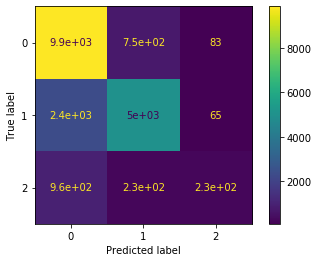

In [268]:
plot_confusion_matrix(trained_model,X_test,y_test)

In [269]:
import matplotlib.pyplot as plt

In [270]:
plt.figure(figsize=(20,30))

<Figure size 1440x2160 with 0 Axes>

<Figure size 1440x2160 with 0 Axes>

# RFC

In [1]:
from sklearn.ensemble import RandomForestClassifier

In [2]:
rc = RandomForestClassifier()

In [4]:
X = pd.read_pickle('X.pkl')
y = pd.read_pickle('y.pkl')

In [9]:
rc.fit(X_train,y_train)

RandomForestClassifier()

In [10]:
y_pred = rc.predict(X_test)

In [14]:
accuracy_score(y_test,y_pred)

0.7911437608407306

In [17]:
confusion_matrix(y_test,y_pred)

array([[9211, 1115,  393],
       [1494, 5788,  176],
       [ 682,  234,  509]])